# Insurance Fund Risk Analysis

## Load and Process Data

In [1]:
from datetime import datetime
import os
import json
import pandas as pd
import plotly.graph_objects as go
import plotly.express as px
import requests
import time
from ciso8601 import parse_datetime
import csv

pd.options.plotting.backend = "plotly"

In [2]:
import plotly.io as pio
pio.renderers.default='browser'

import plotly.offline as pyo
import plotly.graph_objs as go
pyo.init_notebook_mode()

In [3]:
import numpy as np

In [4]:
import warnings
warnings.filterwarnings('ignore')

In [5]:
#import funding data
btc_funding=pd.read_csv('dat/XBTUSD_funding_bitmex.csv')
btc_funding['timestamp'] = pd.to_datetime(btc_funding['timestamp'],utc='True')
btc_funding = btc_funding.sort_values(by='timestamp',ascending=True)

sol_funding=pd.read_csv('dat/SOLPERP_funding_ftx.csv')
sol_funding=sol_funding.sort_values(by='time',ascending=True)
sol_funding['timestamp'] = sol_funding['time']
sol_funding['fundingRate'] = sol_funding['rate']

#import spot data
btc_spot = pd.read_csv('dat/gemini_BTCUSD_1hr.csv')
#btc_spot['timestamp'] = btc_spot['Date'].astype(datetime)
btc_spot['timestamp'] = pd.to_datetime(btc_spot['Date'],utc='True')
btc_spot = btc_spot.sort_values(by='Date',ascending=True)
btc_spot.columns = map(str.lower, btc_spot.columns)

sol_spot = pd.read_csv('dat/SOL_spot_FTX_1h.csv')
sol_spot['timestamp']=sol_spot['startTime']
sol_spot=sol_spot.sort_values(by='timestamp',ascending=False)

#combine spot and funding data
sol_joined = pd.merge(sol_funding,sol_spot,on=['timestamp'],how='left')
btc_joined = pd.merge(btc_funding,btc_spot,on=['timestamp'],how='left')


## Explore Data

We will be using data from two different perpetual futures for our analysis: XBTUSD futures on BITMEX and SOLPERP futures on FTX since these have the longest histories available, but we can perform the analysis with other futures too.

BTC and SOL data were pulled from GEMINI and FTX respectively.


### BTC Spot and Funding Data

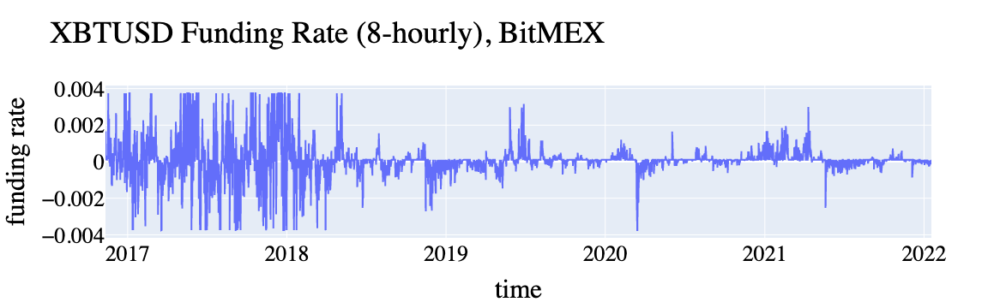

In [6]:
fig = go.Figure()
fig = fig.add_trace(go.Scatter(x=btc_joined['timestamp'], y=btc_joined['fundingRate'],name='funding rate'))
fig['layout'].update(title='XBTUSD Funding Rate (8-hourly), BitMEX')
fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='funding rate')
fig.show()



fig.write_image("fig/btc_funding_raw.pdf", width=6*300, height=2*300)

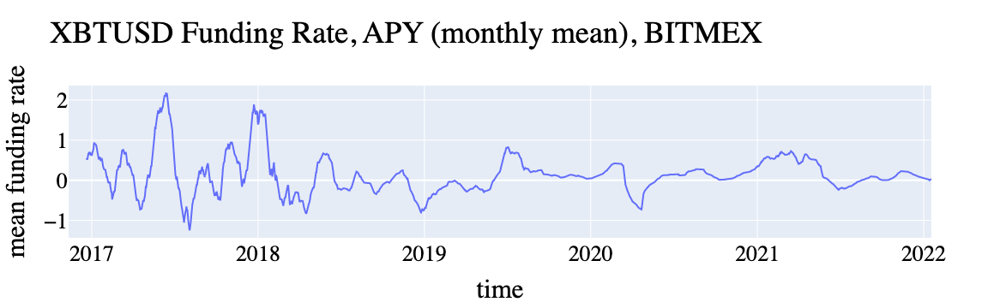

In [7]:
btc_joined['fundingRate_apy_monthly'] = btc_joined['fundingRate'].rolling(window=4*30).mean()*4*365
fig = go.Figure()
fig = fig.add_trace(go.Scatter(x=btc_joined['timestamp'], y=btc_joined['fundingRate_apy_monthly'],name='funding rate'))
fig['layout'].update(title='XBTUSD Funding Rate, APY (monthly mean), BITMEX')
fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='mean funding rate')
fig.show()



fig.write_image("fig/btc_funding_avg.pdf", width=6*300, height=2*300)

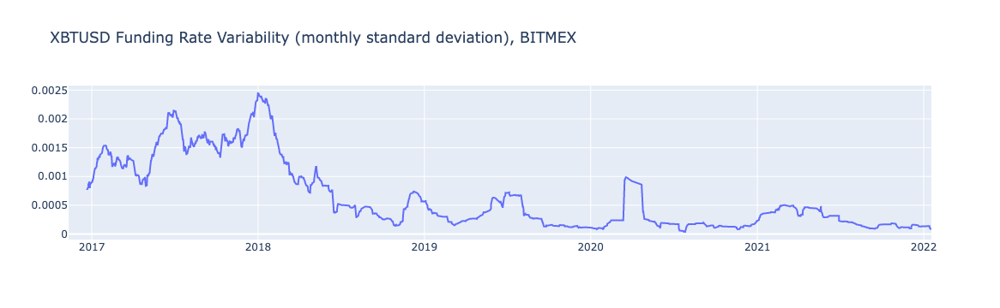

In [8]:
btc_joined['fundingRate_std_monthly'] = btc_joined['fundingRate'].rolling(window=4*30).std()
fig = go.Figure()
fig = fig.add_trace(go.Scatter(x=btc_joined['timestamp'], y=btc_joined['fundingRate_std_monthly'],name='funding rate'))
fig['layout'].update(title='XBTUSD Funding Rate Variability (monthly standard deviation), BITMEX')
fig.show()

fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='standard deviation of funding rate')

fig.write_image("fig/btc_funding_std.pdf", width=6*300, height=2*300)

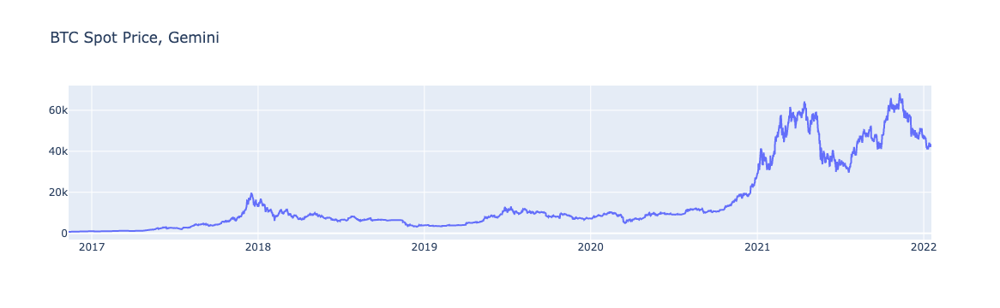

In [9]:
fig = go.Figure()
fig = fig.add_trace(go.Scatter(x=btc_joined['timestamp'], y=btc_joined['close'],name='spot price'))
fig['layout'].update(title='BTC Spot Price, Gemini')
fig.show()

fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='spot price')
fig.write_image("fig/btc_spot.pdf", width=6*300, height=2*300)

### SOL Spot and Funding Data

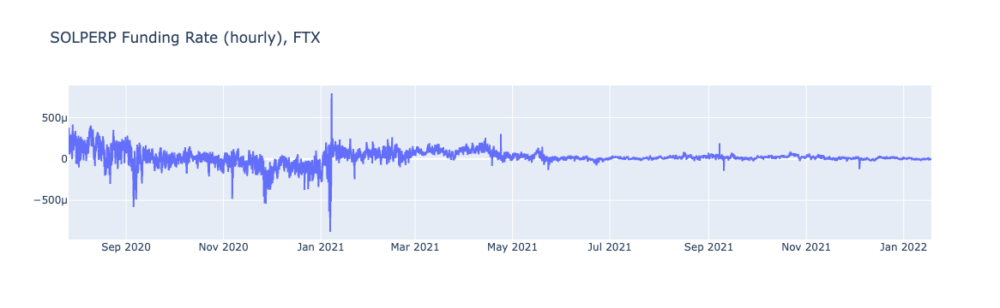

In [10]:
fig = go.Figure()
fig = fig.add_trace(go.Scatter(x=sol_joined['timestamp'], y=sol_joined['fundingRate'],name='funding_rate'))
fig['layout'].update(title='SOLPERP Funding Rate (hourly), FTX')
fig.show()

fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='funding rate (μ=1e-6)')


fig.write_image("fig/sol_funding_raw.pdf", width=6*300, height=2*300)

In [11]:
sol_joined['fundingRate_monthly_apy'] = sol_joined['fundingRate'].rolling(window=24*30).mean()*24*365

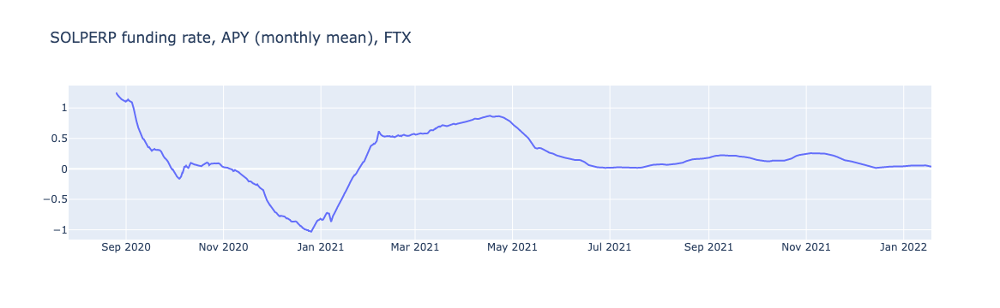

In [12]:
fig = go.Figure()
fig = fig.add_trace(go.Scatter(x=sol_joined['timestamp'], y=sol_joined['fundingRate_monthly_apy'],name='funding_rate'))
fig['layout'].update(title='SOLPERP funding rate, APY (monthly mean), FTX')
fig.show()

fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='SOLPERP mean funding rate') 

fig.write_image("fig/sol_funding_avg.pdf", width=6*300, height=2*300)


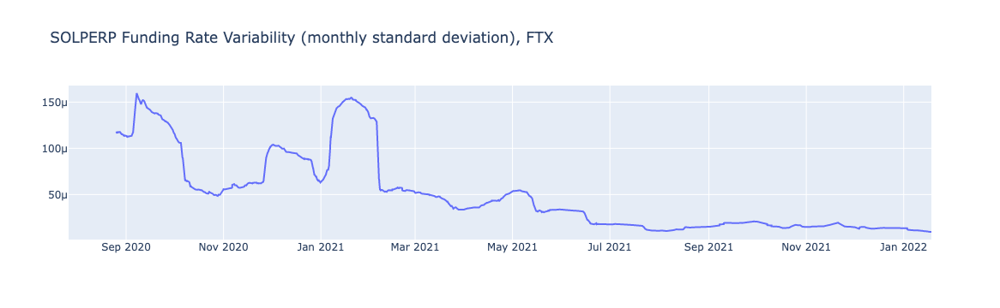

In [13]:
sol_joined['fundingRate_std_monthly'] = sol_joined['fundingRate'].rolling(window=24*30).std()
fig = go.Figure()
fig = fig.add_trace(go.Scatter(x=sol_joined['timestamp'], y=sol_joined['fundingRate_std_monthly'],name='funding rate'))
fig['layout'].update(title='SOLPERP Funding Rate Variability (monthly standard deviation), FTX')
fig.show()

fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='standard deviation of funding rate')

fig.write_image("fig/sol_funding_std.pdf", width=6*300, height=2*300)

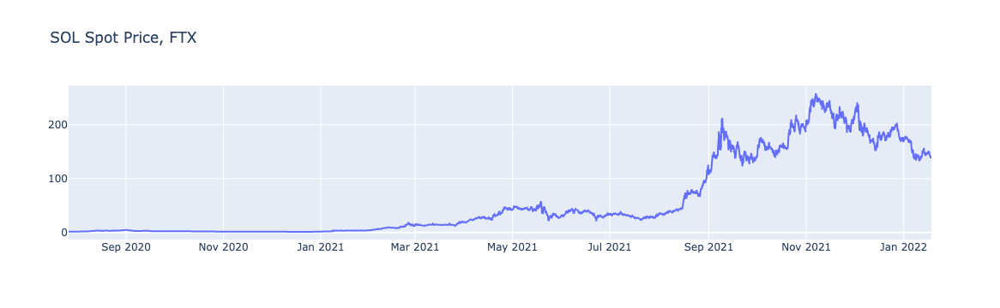

In [14]:
fig = go.Figure()
fig = fig.add_trace(go.Scatter(x=sol_joined['timestamp'], y=sol_joined['close'],name='spot_price'))
fig['layout'].update(title='SOL Spot Price, FTX')
fig.show()
fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='spot price')

fig.write_image("fig/sol_spot.pdf", width=6*300, height=2*300)

## Simulate

### Simulation Description

The simulation is flexible and has the following options available:

Inputs:
ins_size = initial size of insurance fund 

start_date = date to start simulation at

dat = time series of perp funding rates and spot in format of sol_joined or btc_joined

market_cap = market cap of UXD

fix_price = fixes underlying price at initial value

testRate = signals to use the fundingRate_test column for funding calculations instead of the fundingRate column

fix_size = signals to use the 'amt_outstanding' column containing increase amounts at each period and 'amt_outstanding' col to calculate current amount outstanding

replenish_percent = (default 1) denotes portion of positive funding payments that go to the insurance fund

Outputs:
A time series containing the balance of the insurance fund at each point in time after start_date

Overview of calculation:
1. Assume ins_size = $57mm at time 0
2. Set num_perp = market_cap/spot_price at time=0
3. ins_size[t] = ins_size[t-1] + num_perp*spot_price[t] + funding_rate[t] = ins_size[0] + num_perp* sum_{0}^{end} spot_price[t]*funding_rate[t]

In [15]:
def simulate_ins_fund(ins_size,start_date,market_cap,dat,replenish_percent=1,fix_price=True,fix_size=True,testRate=False):
    df_temp = dat.loc[dat['timestamp'] >= start_date] #get all rows starting at that date
    start_price = df_temp['close'].iloc[0] #get start price
    num_perp = market_cap/start_price #calculate number of shares of future being held
    
    #get partial sums of spot_price*funding rate
    rateColName = 'fundingRate'
    if testRate:
        rateColName = 'fundingRate_test'
    df_temp['fund_contrib'] = df_temp['close']*df_temp[rateColName]
    if fix_price:
        df_temp['fund_contrib'] = start_price*df_temp[rateColName]
    
    #if fix_size=False:
    #num_perp[t] = num_perp[t-1] + (outstanding[t] - outstanding[t-1])/close[t]
    df_temp['fund_payments'] = df_temp['fund_contrib']*num_perp 
    
    if not fix_size:
        #df_temp['amt_outstanding'] = df_temp['increase_amt'].cumsum() + market_cap
        df_temp['fund_payments'] = df_temp['amt_outstanding'] * df_temp[rateColName]
    
    #adjust payments so only replenish_percent of positive payments go to insurance fund
    
    df_temp.loc[df_temp['fund_payments']>0,'fund_payments']*=replenish_percent

        
    df_temp['ins_balance'] = df_temp['fund_payments'].cumsum() + ins_size
    return df_temp

In [16]:
#given time series of funding payments and investment returns calculates insurance balance

def simulate_insurance_investments(initial_balance,funding):
    joined = funding 
    new_balances = [initial_balance]
    for i, row in joined.iterrows():
        cur_balance = new_balances[-1]*(1+row['returns']) + row['fund_payments']
        new_balances.append(cur_balance)
        
    dates = joined['timestamp'].tolist()
    return pd.DataFrame(list(zip(dates,new_balances)),columns=['timestamp','ins_balance'])

### Example: Behavior of insurance fund starting at given date:

In [17]:
ins_size = 57e6
start_date='2021-01-31T00:00:00+00:00'
market_cap = 5e8 
ins_sim = simulate_ins_fund(ins_size,start_date,market_cap,sol_joined)
ins_sim_btc = simulate_ins_fund(ins_size,start_date,market_cap,btc_joined)

ins_sim_50 = simulate_ins_fund(ins_size,start_date,market_cap,sol_joined,replenish_percent=0.5) #only 50% of insurance payments go to insurance fund
ins_sim_50_btc = simulate_ins_fund(ins_size,start_date,market_cap,btc_joined,replenish_percent=0.5) #only 50% of insurance payments go to insurance fund

#### SOL

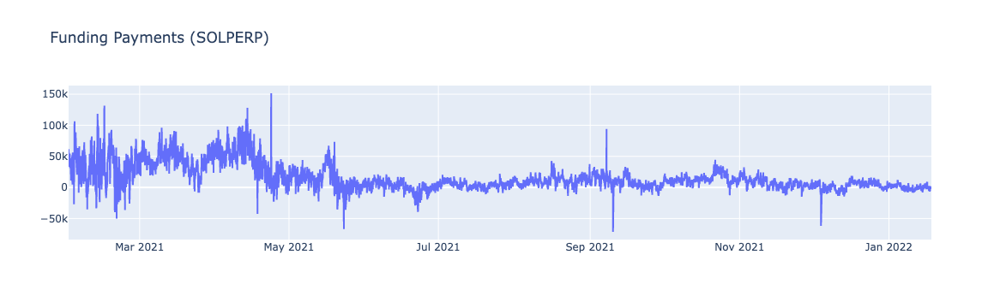

In [18]:
fig = go.Figure()
fig = fig.add_trace(go.Scatter(x=ins_sim['timestamp'], y=ins_sim['fund_payments'],name='fund_payments'))
fig['layout'].update(title=f'Funding Payments (SOLPERP)')
fig.show()

fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='payment amount')

fig.write_image("fig/sol_funding_sim.pdf", width=6*300, height=2*300)





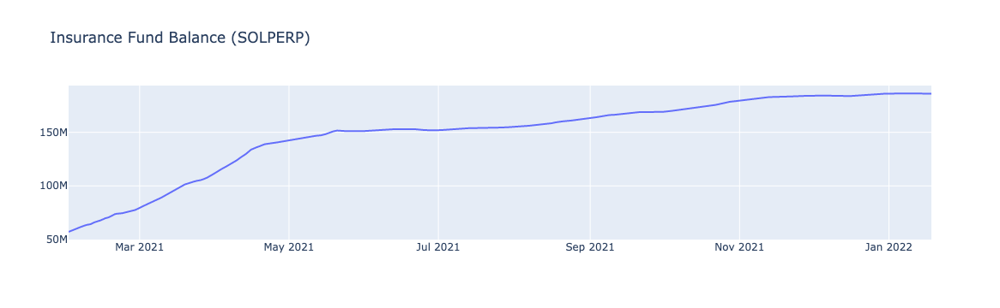

In [19]:
fig = go.Figure()
fig = fig.add_trace(go.Scatter(x=ins_sim['timestamp'], y=ins_sim['ins_balance'],name='ins_balance'))
fig['layout'].update(title=f'Insurance Fund Balance (SOLPERP)')
fig.show()

fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='balance')

fig.write_image("fig/sol_balance_sim.pdf", width=6*300, height=2*300)


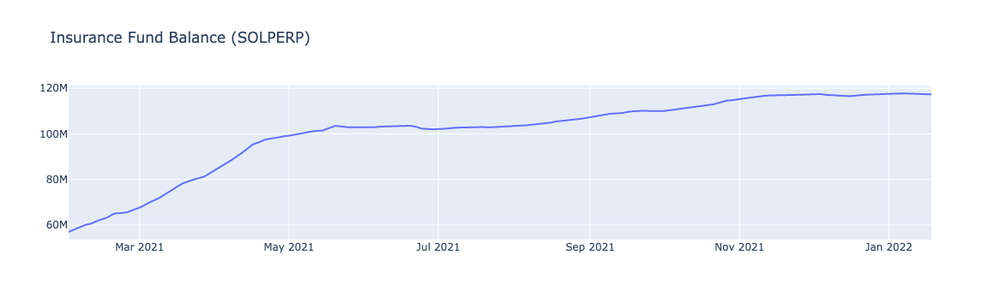

In [20]:
fig = go.Figure()
fig = fig.add_trace(go.Scatter(x=ins_sim_50['timestamp'], y=ins_sim_50['ins_balance'],name='ins_balance'))
fig['layout'].update(title=f'Insurance Fund Balance (SOLPERP)')
fig.show()

fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='balance')

fig.write_image("fig/sol_balance_sim_50.pdf", width=6*300, height=2*300)



These calculations are performed with the assumption that the notional value of the short position remains fixed.  We see more moderate growth, primarily driven by the high funding rates in the first half of 2021.  If we were to remove this assumption, we see much higher returns. This is because during the period(01/30/2021 - 12/29/2021), SOL experienced 4400% price growth. Since the short positions are demonitated in SOL, this caused the initial notional value of the underlying long and short positions to grow correspondingly. 

#### BTC

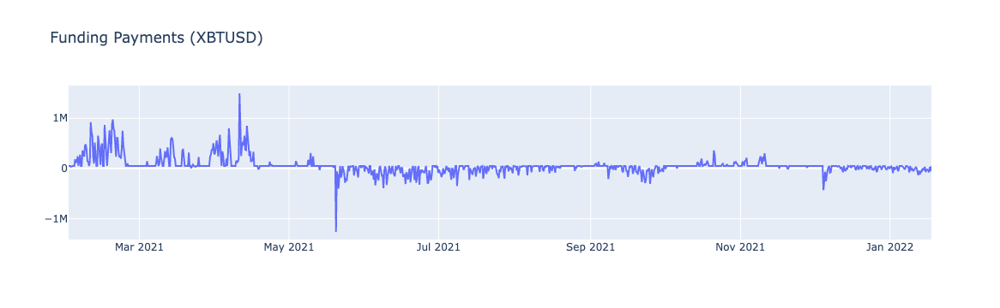

In [21]:
fig = go.Figure()
fig = fig.add_trace(go.Scatter(x=ins_sim_btc['timestamp'], y=ins_sim_btc['fund_payments'],name='fund_payments'))
fig['layout'].update(title=f'Funding Payments (XBTUSD)')
fig.show()

fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='payment amount')

fig.write_image("fig/btc_funding_sim.pdf", width=6*300, height=2*300)



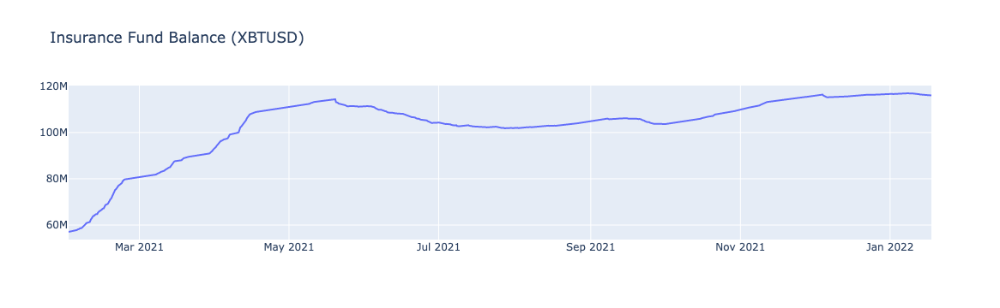

In [22]:
fig = go.Figure()
fig = fig.add_trace(go.Scatter(x=ins_sim_btc['timestamp'], y=ins_sim_btc['ins_balance'],name='ins_balance'))
fig['layout'].update(title=f'Insurance Fund Balance (XBTUSD)')
fig.show()

fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='balance')

fig.write_image("fig/btc_balance_sim.pdf", width=6*300, height=2*300)



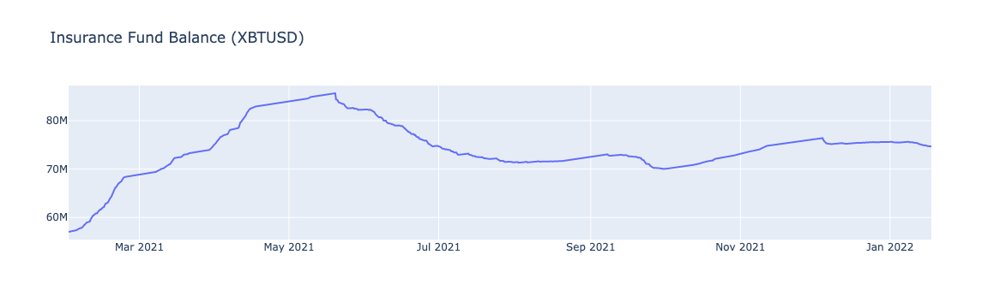

In [23]:
fig = go.Figure()
fig = fig.add_trace(go.Scatter(x=ins_sim_50_btc['timestamp'], y=ins_sim_50_btc['ins_balance'],name='ins_balance'))
fig['layout'].update(title=f'Insurance Fund Balance (XBTUSD)')
fig.show()

fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='balance')

fig.write_image("fig/btc_balance_sim_50.pdf", width=6*300, height=2*300)


### Effects of insurance fund returns

#### SOL

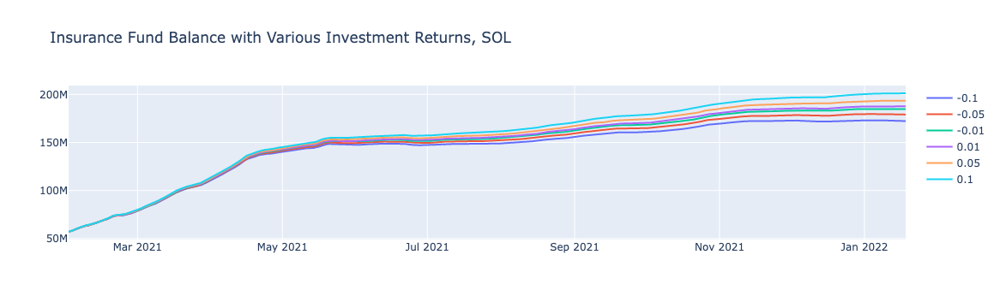

In [24]:
fig = go.Figure()
initial_balance=57e6
funding=ins_sim
returns = [-.1,-.05,-.01,.01,.05,.1]
for r in returns:
    funding['returns'] = r/365/24 #convert to hourly
    res = simulate_insurance_investments(initial_balance,funding)
    fig = fig.add_trace(go.Scatter(x=res['timestamp'],y=res['ins_balance'],name=str(r)))
fig['layout'].update(title='Insurance Fund Balance with Various Investment Returns, SOL')
fig.show()

fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='balance')

fig.write_image("fig/SOL_balance_sim_ret.pdf", width=6*300, height=2*300)

#### BTC

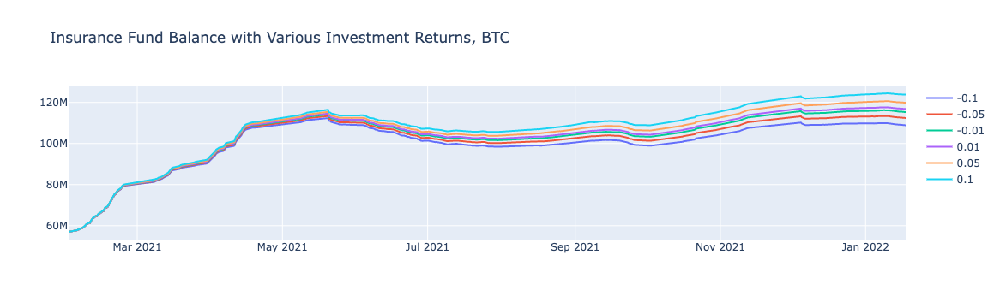

In [25]:
fig = go.Figure()
initial_balance=57e6
funding_btc=ins_sim_btc
returns = [-.1,-.05,-.01,.01,.05,.1]
for r in returns:
    funding_btc['returns'] = r/365/4 #convert to 8-hourly
    res = simulate_insurance_investments(initial_balance,funding_btc)
    fig = fig.add_trace(go.Scatter(x=res['timestamp'],y=res['ins_balance'],name=str(r)))
fig['layout'].update(title='Insurance Fund Balance with Various Investment Returns, BTC')
fig.show()

fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='balance')

fig.write_image("fig/BTC_balance_sim_ret.pdf", width=6*300, height=2*300)

### Effects of varying start date

In [26]:
def get_summary_table(ins_size, dates,market_cap,data,replenish_percent=1,fix_price=True,fix_notional=True,curr='sol'):
    results = []
    for start_date in dates:
        #run simulate_ins_fund starting at each date
        if not fix_notional:
            dat_trim = data.loc[data['timestamp'] >= start_date]
            df_input = join_schedule(df_trim,outstanding_schedule,curr)
        else:
            df_input=data
        sim_result = simulate_ins_fund(ins_size,start_date,market_cap,df_input,replenish_percent,fix_price)
        first_zero_day = sim_result[sim_result['ins_balance'] < 0]['timestamp'].min()
        sim_result['ins_balance'] = sim_result['ins_balance'].clip(lower=0)
        sum_stats = sim_result['ins_balance'].describe().to_dict()
        
        #get first date where value is less than zero
        sum_stats['first_zero_day'] = first_zero_day
        sum_stats['start_date'] = start_date
        results.append(sum_stats)
        
    df = pd.DataFrame(results).set_index('start_date')
    return df

In [27]:
sol_joined['time']=pd.to_datetime(sol_joined['timestamp']).dt.time.apply(lambda x: x.strftime("%H:%M:%S"))
all_sol_dates = sol_joined.loc[sol_joined['time'] == "00:00:00"]['timestamp'].tolist()[:-1]

sum_tab_sol = get_summary_table(ins_size=57e6,dates=all_sol_dates,market_cap=500e6,data=sol_joined,replenish_percent=1,fix_price=True)
sum_tab_sol_50 = get_summary_table(ins_size=57e6,dates=all_sol_dates,market_cap=500e6,data=sol_joined,replenish_percent=0.5,fix_price=True)

#### SOL

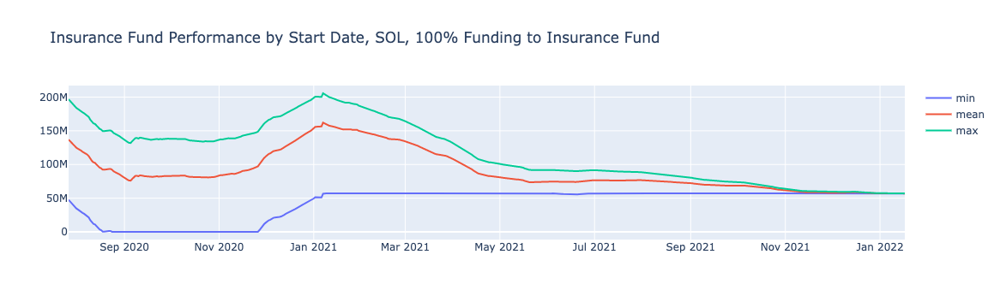

In [28]:
sum_tab_sol = sum_tab_sol.reset_index(drop=False)
fig = go.Figure()
initial_balance=57e6
funding_btc=ins_sim_btc
ys = ['min','mean','max']
for yval in ys:
    fig = fig.add_trace(go.Scatter(x=sum_tab_sol['start_date'],y=sum_tab_sol[yval],name=str(yval)))
fig['layout'].update(title='Insurance Fund Performance by Start Date, SOL, 100% Funding to Insurance Fund')
fig.show()

fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='balance')

fig.write_image("fig/sol_balance_date_comp_100.pdf", width=6*300, height=2*300)

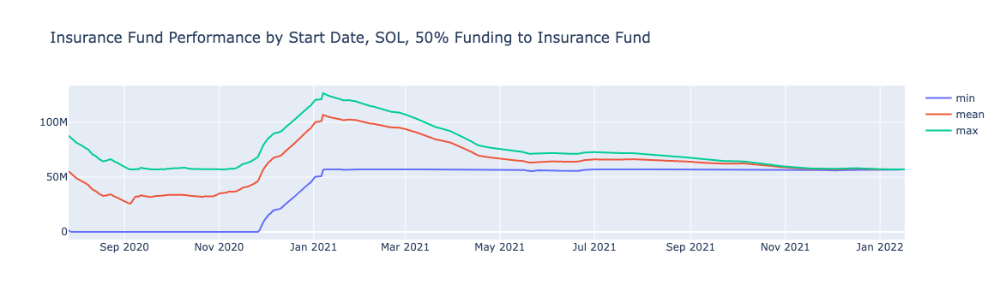

In [29]:
sum_tab_sol_50.plot(y=['min','mean','max'],title='Insurance Fund Performance by Start Date, SOL, 50% funding to insurance fund')

sum_tab_sol_50 = sum_tab_sol_50.reset_index(drop=False)
fig = go.Figure()
ys = ['min','mean','max']
for yval in ys:
    fig = fig.add_trace(go.Scatter(x=sum_tab_sol_50['start_date'],y=sum_tab_sol_50[yval],name=str(yval)))
fig['layout'].update(title='Insurance Fund Performance by Start Date, SOL, 50% Funding to Insurance Fund')
fig.show()

fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='balance')

fig.write_image("fig/sol_balance_date_comp_50.pdf", width=6*300, height=2*300)

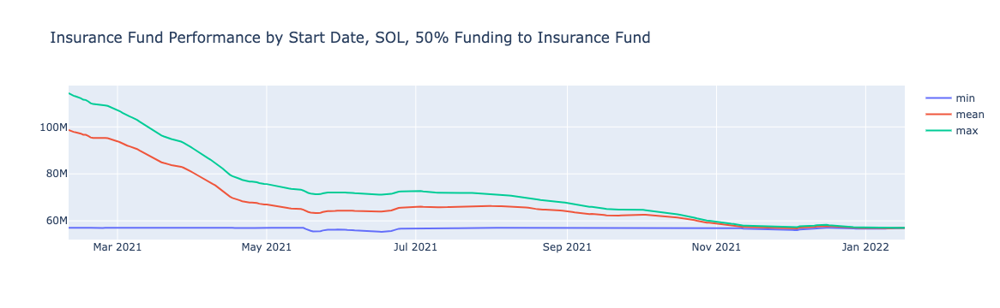

In [30]:
sum_tab_sol_50[200:].plot(y=['min','mean','max'],title='Insurance Fund Performance by Start Date, SOL, 50% funding to insurance fund')

sum_tab_sol_50.plot(y=['min','mean','max'],title='Insurance Fund Performance by Start Date, SOL, 50% funding to insurance fund')

fig = go.Figure()
ys = ['min','mean','max']
for yval in ys:
    fig = fig.add_trace(go.Scatter(x=sum_tab_sol_50[200:]['start_date'],y=sum_tab_sol_50[200:][yval],name=str(yval)))
fig['layout'].update(title='Insurance Fund Performance by Start Date, SOL, 50% Funding to Insurance Fund')
fig.show()

fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='balance')

fig.write_image("fig/sol_balance_date_comp_50_zoom.pdf", width=6*300, height=2*300)

#### BTC

In [31]:
btc_joined['time']=pd.to_datetime(btc_joined['timestamp']).dt.time.apply(lambda x: x.strftime("%H:%M:%S"))
all_btc_dates = btc_joined.loc[btc_joined['time'] == "12:00:00"]['timestamp'].tolist()[:-1]
all_btc_dates = [str(x) for x in all_btc_dates]

In [32]:
sum_tab_btc = get_summary_table(ins_size=57e6,dates=all_btc_dates[0:],market_cap=500e6,data=btc_joined,replenish_percent=1,fix_price=True)
sum_tab_btc_50 = get_summary_table(ins_size=57e6,dates=all_btc_dates[0:],market_cap=500e6,data=btc_joined,replenish_percent=0.5,fix_price=True)

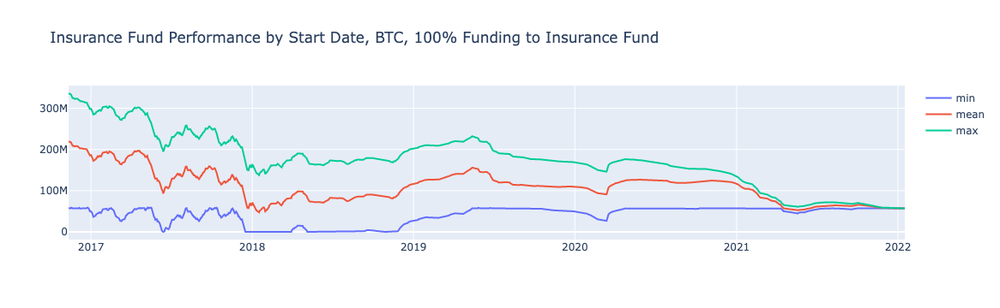

In [33]:
sum_tab_btc = sum_tab_btc.reset_index(drop=False)
fig = go.Figure()
ys = ['min','mean','max']
for yval in ys:
    fig = fig.add_trace(go.Scatter(x=sum_tab_btc['start_date'],y=sum_tab_btc[yval],name=str(yval)))
fig['layout'].update(title='Insurance Fund Performance by Start Date, BTC, 100% Funding to Insurance Fund')
fig.show()

fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='balance')

fig.write_image("fig/btc_balance_date_comp_100.pdf", width=6*300, height=2*300)

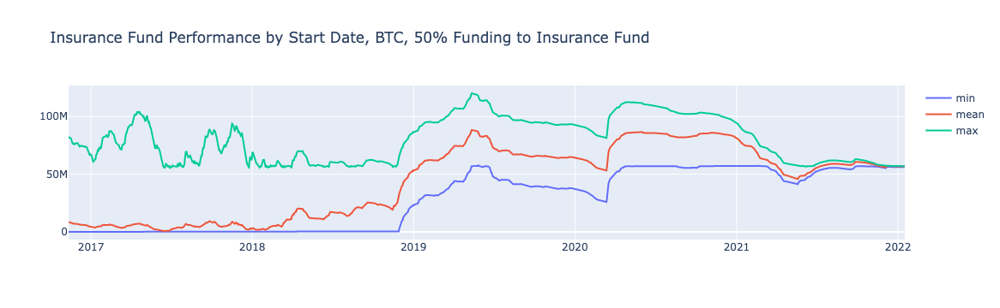

In [34]:
sum_tab_btc_50 = sum_tab_btc_50.reset_index(drop=False)
fig = go.Figure()
ys = ['min','mean','max']
for yval in ys:
    fig = fig.add_trace(go.Scatter(x=sum_tab_btc_50['start_date'],y=sum_tab_btc_50[yval],name=str(yval)))
fig['layout'].update(title='Insurance Fund Performance by Start Date, BTC, 50% Funding to Insurance Fund')
fig.show()

fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='balance')

fig.write_image("fig/btc_balance_date_comp_50.pdf", width=6*300, height=2*300)

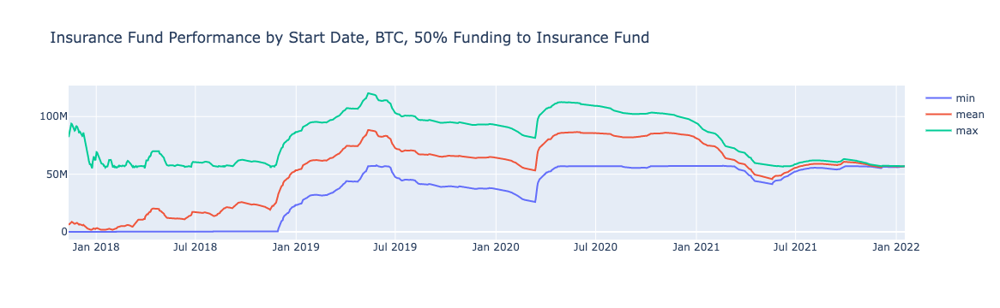

In [35]:
sum_tab_btc_50 = sum_tab_btc_50.reset_index(drop=False)
fig = go.Figure()
ys = ['min','mean','max']
for yval in ys:
    fig = fig.add_trace(go.Scatter(x=sum_tab_btc_50[365:]['start_date'],y=sum_tab_btc_50[365:][yval],name=str(yval)))
fig['layout'].update(title='Insurance Fund Performance by Start Date, BTC, 50% Funding to Insurance Fund')
fig.show()

fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='balance')

fig.write_image("fig/btc_balance_date_comp_50_zoom.pdf", width=6*300, height=2*300)

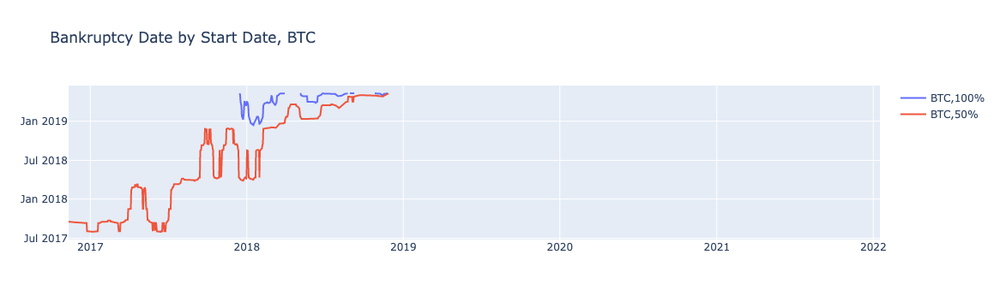

In [36]:
fig = go.Figure()
fig = fig.add_trace(go.Scatter(x=sum_tab_btc['start_date'], y=sum_tab_btc['first_zero_day'],name='BTC,100%'))
fig = fig.add_trace(go.Scatter(x=sum_tab_btc_50['start_date'], y=sum_tab_btc_50['first_zero_day'],name='BTC,50%'))     
                    
fig['layout'].update(title='Bankruptcy Date by Start Date, BTC')
fig.show()

fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='balance')

fig.write_image("fig/btc_bankrupcy.pdf", width=6*300, height=2*300)

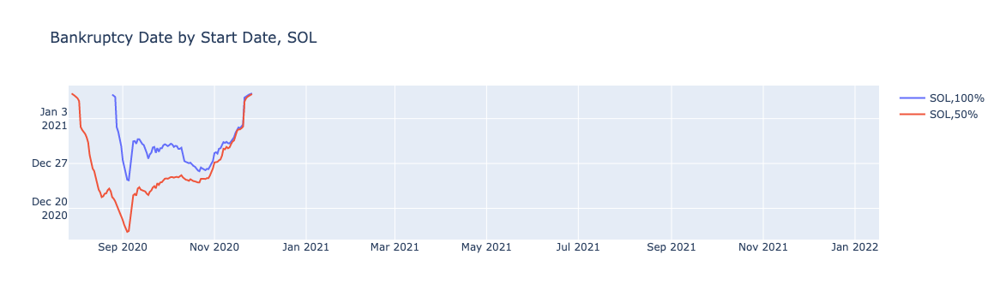

In [37]:
fig = go.Figure()

fig = fig.add_trace(go.Scatter(x=sum_tab_sol['start_date'], y=sum_tab_sol['first_zero_day'],name='SOL,100%'))
fig = fig.add_trace(go.Scatter(x=sum_tab_sol_50['start_date'], y=sum_tab_sol_50['first_zero_day'],name='SOL,50%'))

fig['layout'].update(title='Bankruptcy Date by Start Date, SOL')
fig.show()

fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='balance')

fig.write_image("fig/sol_bankrupcy.pdf", width=6*300, height=2*300)

## Scenarios

#### Examine historical funding rates (SOLPERP)

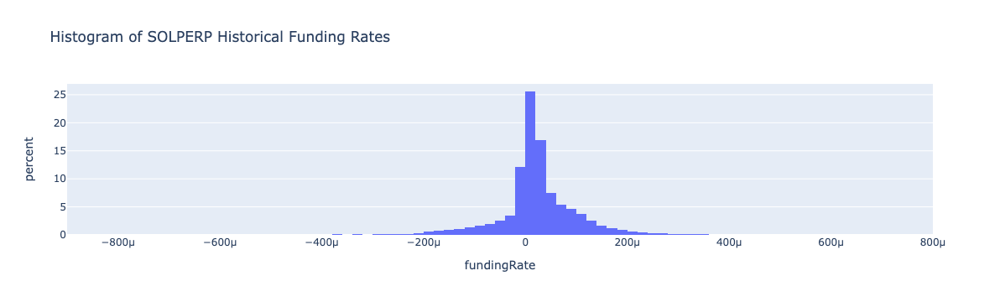

In [39]:
fig = px.histogram(sol_joined,x='fundingRate',nbins=100,title='Histogram of SOLPERP Historical Funding Rates',histnorm='percent')
fig.show()

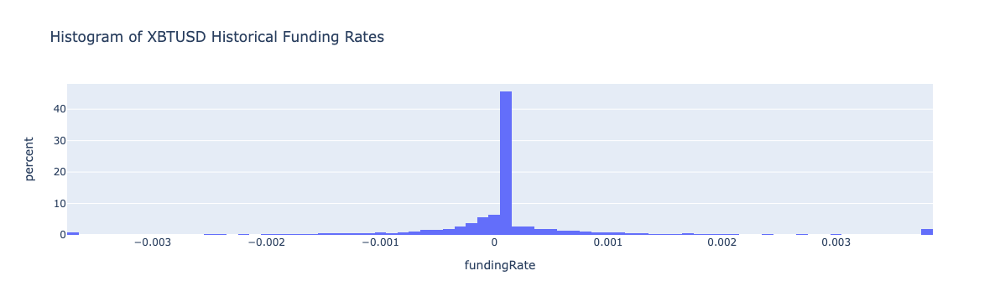

In [40]:
fig = px.histogram(btc_joined,x='fundingRate',nbins=100,title='Histogram of XBTUSD Historical Funding Rates',histnorm='percent')
fig.show()

In [41]:
#daily rate percentiles
#get sum of rate in past day from each data point 
dt = '1D'
sol_joined['fr_lb_1d']= sol_joined['fundingRate'].rolling(window=24).sum()
sol_joined['fr_lb_1w']=sol_joined['fundingRate'].rolling(window=24*7).sum()
sol_joined['fr_lb_1m']=sol_joined['fundingRate'].rolling(window=24*30).sum()

#daily rate percentiles
#get sum of rate in past day from each data point 
btc_joined['fr_lb_1d']=btc_joined['fundingRate'].rolling(window=4).sum()
btc_joined['fr_lb_1w']=btc_joined['fundingRate'].rolling(window=4*7).sum()
btc_joined['fr_lb_1m']=btc_joined['fundingRate'].rolling(window=4*30).sum()

In [42]:
#create rate data series
funding_quantiles_sol = {} 
for x in [0.01,0.05,0.1,0.9,0.95,0.99]:
    funding_quantiles_sol[str(x)] = sol_joined['fr_lb_1m'].quantile(x)
    
print(funding_quantiles_sol)

{'0.01': -0.08110710000000003, '0.05': -0.06600499999999998, '0.1': -0.031182499999999995, '0.9': 0.060064999999999716, '0.95': 0.06945200000000003, '0.99': 0.09268595000000003}


In [43]:
scen1_results_sol = {}
rate_factor = 30*24 #rate values are monthly but want to simulate continuous rates
rates = funding_quantiles_sol
start_date= '2021-01-01T00:00:00+00:00'
for quantile in rates:
    rate = rates[quantile]
    sol_joined['fundingRate_test'] = rate/rate_factor
    result = simulate_ins_fund(ins_size,start_date,market_cap,sol_joined,replenish_percent=1,fix_price=True,testRate=True)
    scen1_results_sol[quantile] = result

fig=go.Figure()
for _rate in scen1_results_sol.keys():
    if float(_rate) > 0.5:
        continue
    _df = scen1_results_sol[_rate]
    fig.add_trace(go.Scatter(x=_df.timestamp, y=_df['ins_balance'],name='Quantile: '+str(_rate),showlegend=True))
fig['layout'].update(title='Insurance balance assuming xth percentile monthly rates hold indefinitely, SOL')

Layout({
    'template': '...', 'title': {'text': 'Insurance balance assuming xth percentile monthly rates hold indefinitely, SOL'}
})

#### SOL

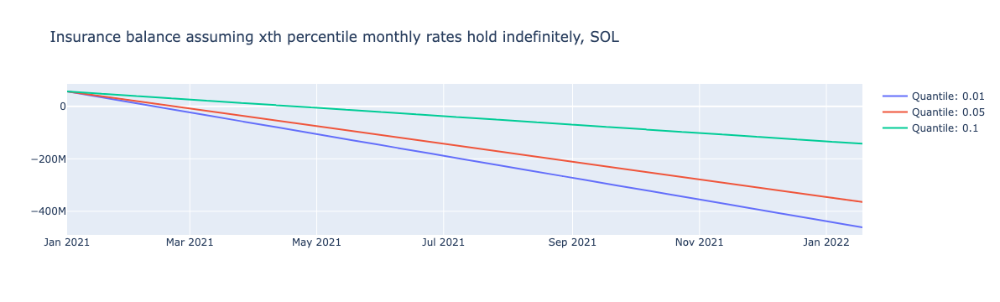

In [44]:
fig.show()

This chart includes (potentially unrepresentative) high rates from before Jan 2021.  If we repeat the same process with rates only starting at Jan 30 2021, we have:  

In [45]:
#create rate data series
funding_quantiles_sol_jan = {} 
for x in [0.01,0.05,0.1,0.9,0.95,0.99]:
    funding_quantiles_sol_jan[str(x)] = sol_joined[4500:]['fr_lb_1m'].quantile(x)
    
print(funding_quantiles_sol_jan)

{'0.01': 0.0012831600000002305, '0.05': 0.0017250000000002417, '0.1': 0.0022926000000002434, '0.9': 0.06076239999999973, '0.95': 0.06747119999999987, '0.99': 0.07100048000000006}


In [46]:
scen1_results_sol_jan = {}
rate_factor = 30*24 #rate values are monthly but want to simulate continuous rates
rates_jan = funding_quantiles_sol_jan
start_date= '2021-01-30T00:00:00+00:00'
for quantile in rates_jan:
    rate = rates_jan[quantile]
    sol_joined['fundingRate_test'] = rate/rate_factor
    result = simulate_ins_fund(ins_size,start_date,market_cap,sol_joined,replenish_percent=1,fix_price=True,testRate=True)
    scen1_results_sol_jan[quantile] = result

fig=go.Figure()
for _rate in scen1_results_sol_jan.keys():
    if float(_rate) > 0.5:
        continue
    _df = scen1_results_sol_jan[_rate]
    fig.add_trace(go.Scatter(x=_df.timestamp, y=_df['ins_balance'],name='Quantile: '+str(_rate),showlegend=True))
fig['layout'].update(title='Insurance balance assuming xth percentile monthly rates hold indefinitely, SOL, 57mm initial balance')

Layout({
    'template': '...',
    'title': {'text': ('Insurance balance assuming xth' ... 'ely, SOL, 57mm initial balance')}
})

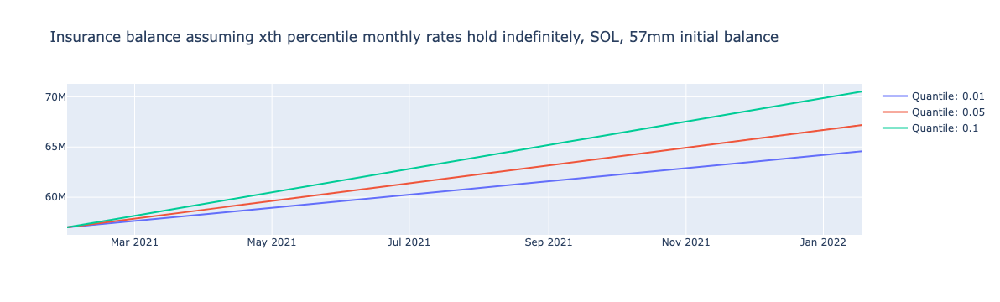

In [47]:
fig.show()

#### Examine historical funding rates (XBTUSD)

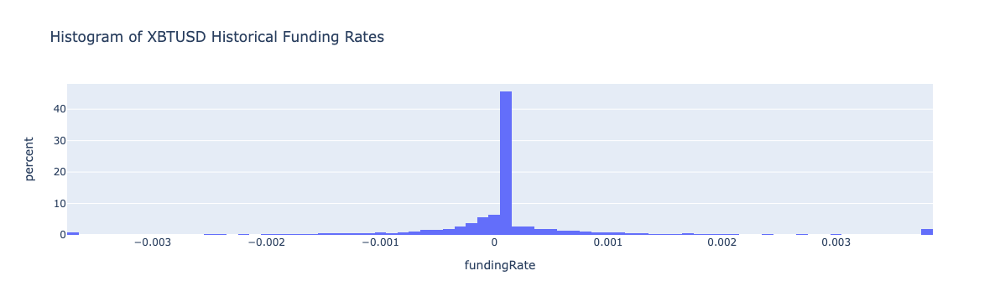

In [48]:
fig = px.histogram(btc_joined,x='fundingRate',nbins=100,title='Histogram of XBTUSD Historical Funding Rates',histnorm='percent')
fig.show()

In [49]:
#create rate data series
funding_quantiles_btc = {} 
for x in [0.01,0.05,0.1,0.9,0.95,0.99]:
    funding_quantiles_btc[str(x)] = btc_joined['fr_lb_1m'].quantile(x)
    
print(funding_quantiles_btc)

{'0.01': -0.06497605999999986, '0.05': -0.04615459999999987, '0.1': -0.03137399999999994, '0.9': 0.05429840000000006, '0.95': 0.07192659999999991, '0.99': 0.1445919800000003}


In [50]:
scen1_results_btc = {}
rate_factor = 4*24 #rate values are monthly but want to simulate continuous rates
rates = funding_quantiles_btc
start_date= '2021-01-01T00:00:00+00:00'
for quantile in rates:
    rate = rates[quantile]
    btc_joined['fundingRate_test'] = rate/rate_factor
    result = simulate_ins_fund(ins_size,start_date,market_cap,btc_joined,replenish_percent=1,fix_price=True,testRate=True)
    scen1_results_btc[quantile] = result

fig=go.Figure()
for _rate in scen1_results_btc.keys():
    if float(_rate) > 0.5:
        continue
    _df = scen1_results_btc[_rate]
    fig.add_trace(go.Scatter(x=_df.timestamp, y=_df['ins_balance'],name='Quantile: '+str(_rate),showlegend=True))
fig['layout'].update(title='Insurance balance assuming xth percentile monthly rates hold indefinitely, BTC, 500mm outstanding, 57mm initial balance')

Layout({
    'template': '...',
    'title': {'text': ('Insurance balance assuming xth' ... 'standing, 57mm initial balance')}
})

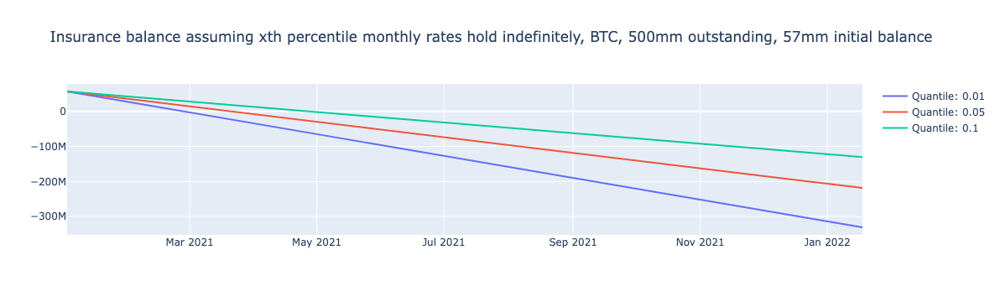

In [51]:
fig.show()

## Variable Outstanding

### Define schedule

In [75]:
outstanding_schedule = [0,1,1,1,1,1,2,2.25,2.5,2.75,3,3.25,3.5,3.75,4,4.25,4.5,4.75,5,5.25,5.5,5.75,6,6.25,6.5,6.75,7,7.25,7.5,7.75,8,8.25,8.5,8.75,9,9.25,9.5,9.75,10,11.5,13,14.5,16,17.5,19,20.5,22,23.5,25,25,25,25,25,25,25,25,25,25,25,25,25,25,25,25,25,25,27.5,30,32.5,35,37.5,40,42.5,45,47.5,50,52.5,55,57.5,60,62.5,65,67.5,70,72.5,75,77.5,80,82.5,85,87.5,90,92.5,95,97.5,100,102.5,105,107.5,110,112.5,115,117.5,120,122.5,125,127.5,130,132.5,135,137.5,140,142.5,145,147.5,150,152.5,155,157.5,160,162.5,165,167.5,170,172.5,175,177.5,180,182.5,185,187.5,190,192.5,195,197.5,200]
print(len(outstanding_schedule))
outstanding_schedule += list(np.linspace(200,1000,229))
outstanding_schedule += [1000]*10
outstanding_schedule=[x*1e6 for x in outstanding_schedule]
fig = go.Figure()
fig.add_trace(go.Scatter(y=outstanding_schedule))
fig['layout'].update(title=f'UXD Release Schedule')
fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='days',yaxis_title='issuance cap')
fig.write_image("fig/UXD_release_schedule.pdf", width=6*300, height=2*300)

136


In [53]:
#dat_joined: a dataframe containing time, funding, spot prices.  This is already clipped to start at desired date.
#start_date: the date to start the outstanding schedule at
#schedule: the schedule by date
#curr: "sol" or "btc"


def join_schedule(dat_joined,schedule,curr):
    freq = 1
    #stretch input to include balance at each time step (1->4,24)
    if curr=='sol':
        freq=24
    elif curr=='btc':
        freq=4

    stretched = np.repeat(outstanding_schedule,freq)
    
    if len(stretched) < len(dat_joined):
        stretched = list(stretched)+[stretched[-1]]*(len(dat_joined) - len(stretched))
    else:
        stretched = stretched[:len(dat_joined)]
    #calculate difference amounts (cumdiff), put in amt_outstanding column
    
    dat_joined['amt_outstanding'] = stretched
    return dat_joined

### Test for single date

#### SOL

In [78]:
ins_size = 57e6
start_date='2021-01-31T00:00:00+00:00'
market_cap = 5e8 

df_trim = sol_joined.loc[sol_joined['timestamp'] >= start_date]
df_input = join_schedule(df_trim,outstanding_schedule,curr='sol')
ins_sim_sched = simulate_ins_fund(ins_size,start_date,market_cap,df_input,fix_size=False)
ins_sim_sched_50 = simulate_ins_fund(ins_size,start_date,market_cap,df_input,fix_size=False,replenish_percent=0.5)

df_trim = btc_joined.loc[btc_joined['timestamp'] >= start_date]
df_input = join_schedule(df_trim,outstanding_schedule,curr='btc')
ins_sim_sched_btc = simulate_ins_fund(ins_size,start_date,market_cap,df_input,fix_size=False)
ins_sim_sched_50_btc = simulate_ins_fund(ins_size,start_date,market_cap,df_input,fix_size=False,replenish_percent=0.5)

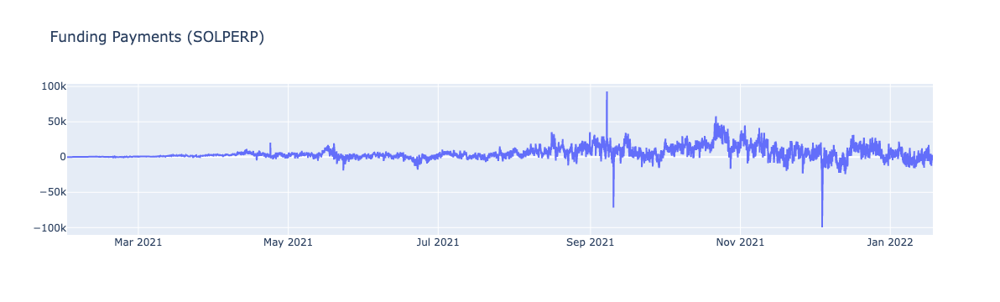

In [79]:
fig = go.Figure()
fig = fig.add_trace(go.Scatter(x=ins_sim_sched['timestamp'], y=ins_sim_sched['fund_payments'],name='fund_payments'))
fig['layout'].update(title=f'Funding Payments (SOLPERP)')
fig.show()

fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='payment amount')

fig.write_image("fig/sol_funding_sim_sched.pdf", width=6*300, height=2*300)





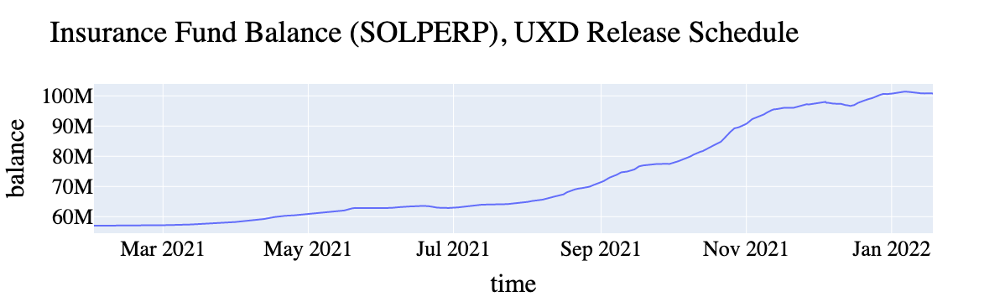

In [84]:
fig = go.Figure()
fig = fig.add_trace(go.Scatter(x=ins_sim_sched['timestamp'], y=ins_sim_sched['ins_balance']))
#fig.add_trace(go.Scatter(x=ins_sim_sched['timestamp'], y=ins_sim_sched['amt_outstanding'],name='amt_outstanding'))

fig['layout'].update(title=f'Insurance Fund Balance (SOLPERP), UXD Release Schedule')
fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='balance')
fig.show()

fig.write_image("fig/sol_balance_sim_sched.pdf", width=6*300, height=2*300)

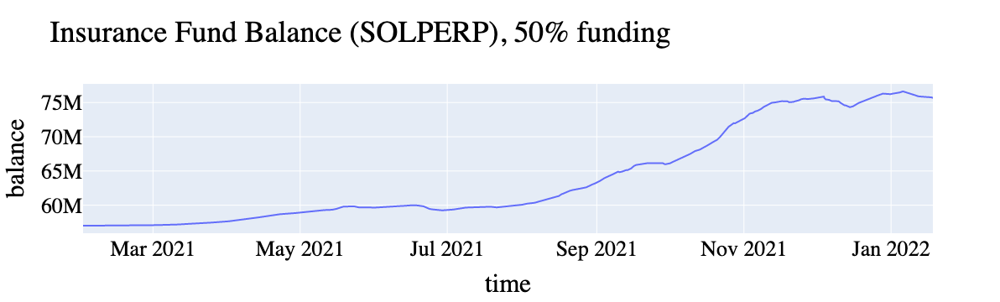

In [85]:
fig = go.Figure()
fig = fig.add_trace(go.Scatter(x=ins_sim_sched_50['timestamp'], y=ins_sim_sched_50['ins_balance']))
#fig.add_trace(go.Scatter(x=ins_sim_sched_50['timestamp'], y=ins_sim_sched_50['amt_outstanding']))

fig['layout'].update(title=f'Insurance Fund Balance (SOLPERP), 50% funding')
fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='balance')
fig.show()

fig.write_image("fig/sol_balance_sim_sched_50.pdf", width=6*300, height=2*300)

#### BTC

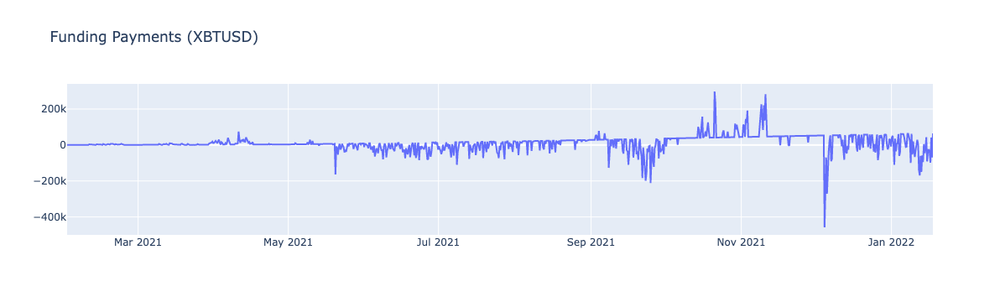

In [94]:
fig = go.Figure()
fig = fig.add_trace(go.Scatter(x=ins_sim_sched_btc['timestamp'], y=ins_sim_sched_btc['fund_payments'],name='fund_payments'))
fig['layout'].update(title=f'Funding Payments (XBTUSD)')
fig.show()

fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='payment amount')

fig.write_image("fig/btc_funding_sim_sched.pdf", width=6*300, height=2*300)





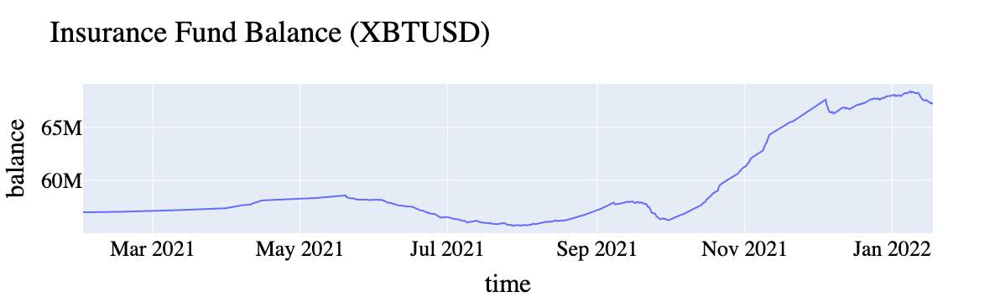

In [93]:
fig = go.Figure()
fig = fig.add_trace(go.Scatter(x=ins_sim_sched_btc['timestamp'], y=ins_sim_sched_btc['ins_balance']))
#fig.add_trace(go.Scatter(x=ins_sim_sched_btc['timestamp'], y=ins_sim_sched_btc['amt_outstanding'],name='amt_outstanding'))

fig['layout'].update(title=f'Insurance Fund Balance (XBTUSD)')
fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='balance')
fig.show()

fig.write_image("fig/btc_balance_sim_sched.pdf", width=6*300, height=2*300)

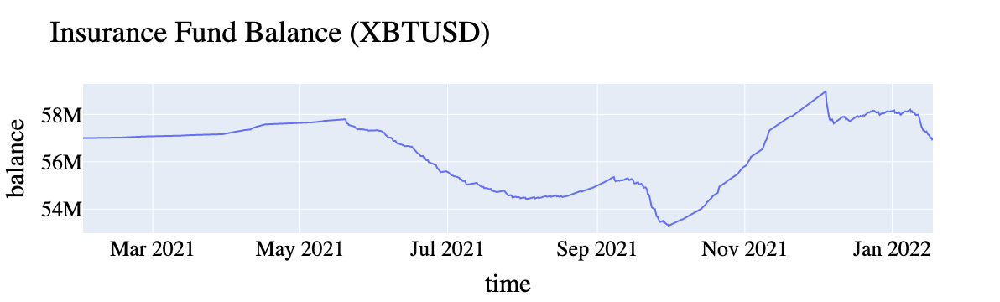

In [92]:
fig = go.Figure()
fig = fig.add_trace(go.Scatter(x=ins_sim_sched_50_btc['timestamp'], y=ins_sim_sched_50_btc['ins_balance'],name='ins_balance'))
#fig.add_trace(go.Scatter(x=ins_sim_sched_50_btc['timestamp'], y=ins_sim_sched_50_btc['amt_outstanding'],name='amt_outstanding'))

fig['layout'].update(title=f'Insurance Fund Balance (XBTUSD)')
fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='balance')

fig.show()

fig.write_image("fig/btc_balance_sim_sched_50.pdf", width=6*300, height=2*300)

### Test for variable dates

#### SOL

In [60]:
sol_joined['time']=pd.to_datetime(sol_joined['timestamp']).dt.time.apply(lambda x: x.strftime("%H:%M:%S"))
all_sol_dates = sol_joined.loc[sol_joined['time'] == "00:00:00"]['timestamp'].tolist()[:-1]

sum_tab_sol_sched = get_summary_table(ins_size=57e6,dates=all_sol_dates,market_cap=500e6,data=sol_joined,replenish_percent=1,fix_price=True,fix_notional=False)
sum_tab_sol_50_sched = get_summary_table(ins_size=57e6,dates=all_sol_dates,market_cap=500e6,data=sol_joined,replenish_percent=0.5,fix_price=True,fix_notional=False)

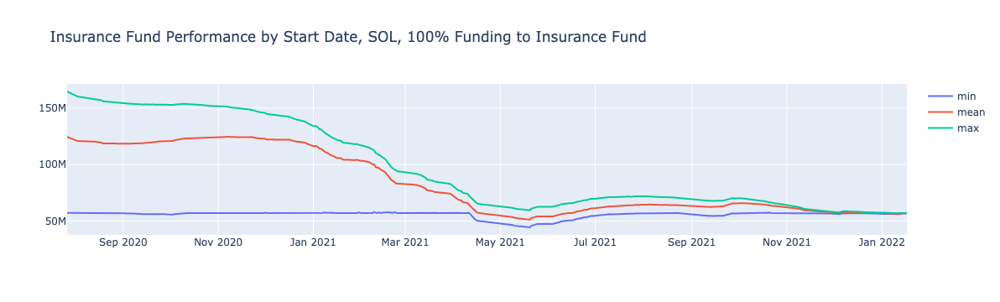

In [95]:
sum_tab_sol_sched = sum_tab_sol_sched.reset_index(drop=False)
fig = go.Figure()
initial_balance=57e6
funding_btc=ins_sim_btc
ys = ['min','mean','max']
for yval in ys:
    fig = fig.add_trace(go.Scatter(x=sum_tab_sol_sched['start_date'],y=sum_tab_sol_sched[yval],name=str(yval)))
fig['layout'].update(title='Insurance Fund Performance by Start Date, SOL, 100% Funding to Insurance Fund')
fig.show()

fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='balance')

fig.write_image("fig/sol_balance_date_comp_100_sched.pdf", width=6*300, height=2*300)

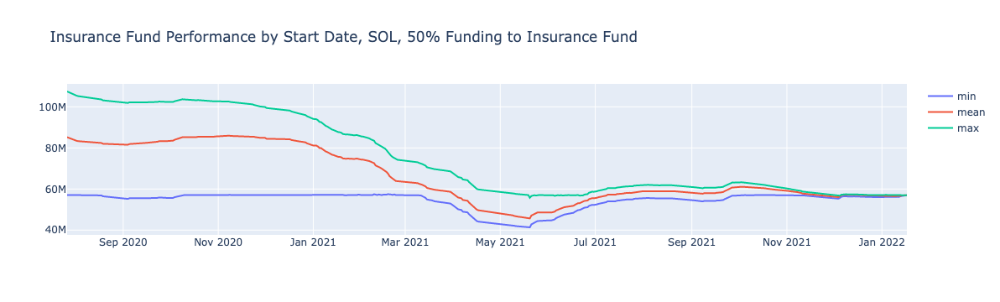

In [98]:
sum_tab_sol_50_sched = sum_tab_sol_50_sched.reset_index(drop=False)
fig = go.Figure()
initial_balance=57e6
funding_btc=ins_sim_btc
ys = ['min','mean','max']
for yval in ys:
    fig = fig.add_trace(go.Scatter(x=sum_tab_sol_50_sched['start_date'],y=sum_tab_sol_50_sched[yval],name=str(yval)))
fig['layout'].update(title='Insurance Fund Performance by Start Date, SOL, 50% Funding to Insurance Fund')
fig.show()

fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='balance')

fig.write_image("fig/sol_balance_date_comp_50_sched.pdf", width=6*300, height=2*300)

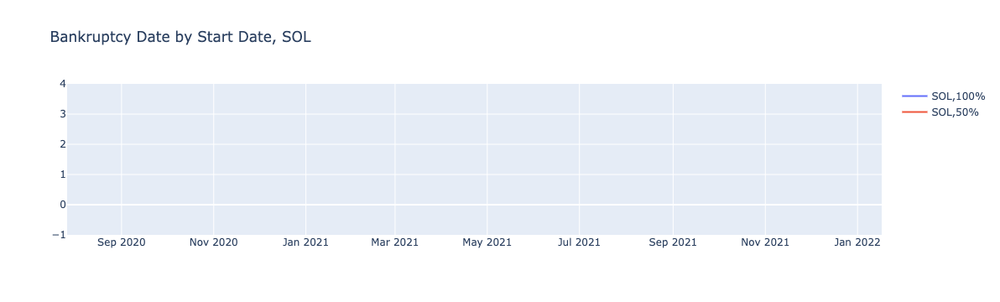

In [99]:
fig = go.Figure()
fig = fig.add_trace(go.Scatter(x=sum_tab_sol_sched['start_date'], y=sum_tab_sol_sched['first_zero_day'],name='SOL,100%'))
fig = fig.add_trace(go.Scatter(x=sum_tab_sol_50_sched['start_date'], y=sum_tab_sol_50_sched['first_zero_day'],name='SOL,50%'))     
                    
fig['layout'].update(title='Bankruptcy Date by Start Date, SOL')
fig.show()

fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='balance')

fig.write_image("fig/sol_bankrupcy_sched.pdf", width=6*300, height=2*300)

#### BTC

In [62]:
btc_joined['time']=pd.to_datetime(btc_joined['timestamp']).dt.time.apply(lambda x: x.strftime("%H:%M:%S"))
all_btc_dates = btc_joined.loc[btc_joined['time'] == "12:00:00"]['timestamp'].tolist()[:-1]
all_btc_dates = [str(x) for x in all_btc_dates]

sum_tab_btc_sched = get_summary_table(ins_size=57e6,dates=all_btc_dates[0:],market_cap=500e6,data=btc_joined,replenish_percent=1,fix_price=True,fix_notional=False,curr='btc')
sum_tab_btc_50_sched = get_summary_table(ins_size=57e6,dates=all_btc_dates[0:],market_cap=500e6,data=btc_joined,replenish_percent=0.5,fix_price=True,fix_notional=False,curr='btc')

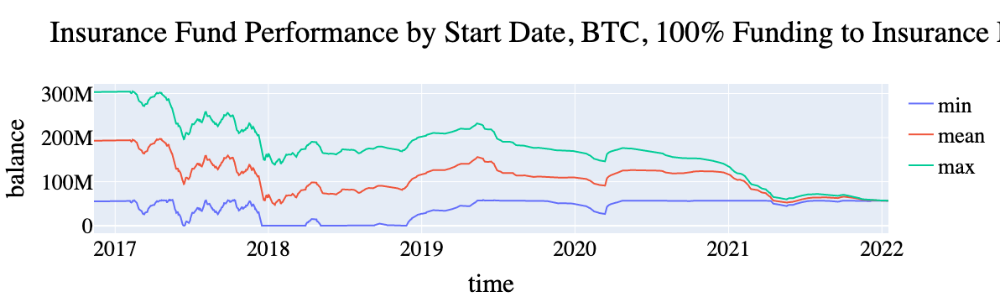

In [102]:
sum_tab_btc_sched = sum_tab_btc_sched.reset_index(drop=False)
fig = go.Figure()
ys = ['min','mean','max']
for yval in ys:
    fig = fig.add_trace(go.Scatter(x=sum_tab_btc_sched['start_date'],y=sum_tab_btc_sched[yval],name=str(yval)))
fig['layout'].update(title='Insurance Fund Performance by Start Date, BTC, 100% Funding to Insurance Fund')
fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='balance')
fig.show()



fig.write_image("fig/btc_balance_date_comp_100_sched.pdf", width=6*300, height=2*300)

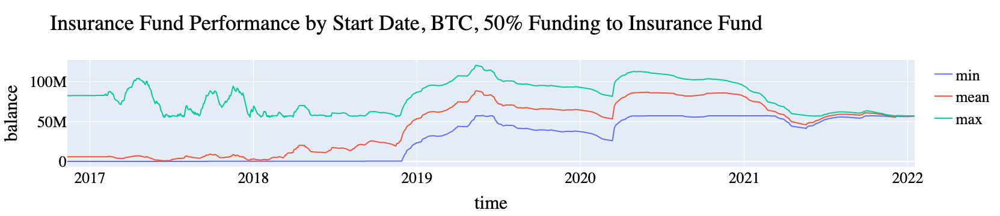

In [66]:
sum_tab_btc_50_sched = sum_tab_btc_50_sched.reset_index(drop=False)
fig = go.Figure()
ys = ['min','mean','max']
for yval in ys:
    fig = fig.add_trace(go.Scatter(x=sum_tab_btc_50_sched['start_date'],y=sum_tab_btc_50_sched[yval],name=str(yval)))
fig['layout'].update(title='Insurance Fund Performance by Start Date, BTC, 50% Funding to Insurance Fund')
fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='balance')
fig.show()



fig.write_image("fig/btc_balance_date_comp_50_sched.pdf", width=6*300, height=2*300)

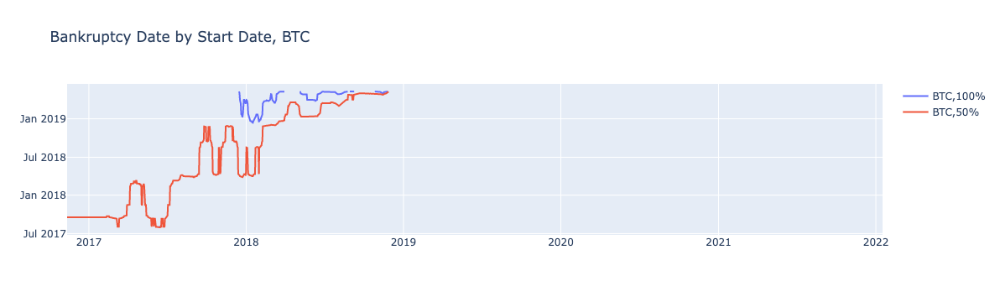

In [100]:
fig = go.Figure()
fig = fig.add_trace(go.Scatter(x=sum_tab_btc_sched['start_date'], y=sum_tab_btc_sched['first_zero_day'],name='BTC,100%'))
fig = fig.add_trace(go.Scatter(x=sum_tab_btc_50_sched['start_date'], y=sum_tab_btc_50_sched['first_zero_day'],name='BTC,50%'))     
                    
fig['layout'].update(title='Bankruptcy Date by Start Date, BTC')
fig.show()

fig.update_layout(font = dict(family="Serif", 
                              color='black',size=26
                              ),xaxis_title='time',yaxis_title='balance')

fig.write_image("fig/btc_bankrupcy_sched.pdf", width=6*300, height=2*300)